# **Mini-Project of IWR**  
### Group 05:
#### 1. SAO SAMARTH
#### 2. YOU PHAKKORN
#### 3. SOK SREYSEEY
#### 4. THORNTHEA GECHHAI
#### 5. TAING KIMMENG

## Topic 05: **Topic Discovery in Research Papers**

**Objective**: Automatically discover topics from abstracts of research papers.  
**Dataset**: Any Dataset  
**Tasks**:  
1. Represent abstracts with TF-IDF or word embeddings.
2. Use clustering techniques (e.g., K-Means) to group papers by topics.
3. Visualize clusters with word clouds or topic frequencies.
4. Interpret clusters using the most common terms in each cluster.
5. Use topic modeling techniques like (LDA) which involve probabilistic ML models.

Install Required Libraries

In [ ]:
!pip install pyLDAvis

Import Required Libraries

In [1]:
import nltk
import numpy as np
import pandas as pd
import re
import gensim
import spacy
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from gensim.models import Word2Vec
from sklearn.preprocessing import LabelEncoder
from gensim.utils import simple_preprocess
from gensim.models import LdaModel, CoherenceModel
from gensim.models.phrases import Phrases, Phraser
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import requests
from bs4 import BeautifulSoup
import os
from pprint import pprint
import ipywidgets as widgets
from IPython.display import display, clear_output
from sklearn.cluster import KMeans
from wordcloud import WordCloud
import pyLDAvis
import pyLDAvis.gensim_models
from collections import Counter

# Download the 'stopwords' dataset
nltk.download('stopwords')
nltk.download('punkt')

# Load the spacy model
spacy.cli.download("en_core_web_sm")

# Ensure to set up visualization
sns.set_context("talk")
sns.set_style("ticks")
%config InlineBackend.figure_format="retina"

[nltk_data] Downloading package stopwords to C:\Users\ROG Zephyrus
[nltk_data]     PC\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to C:\Users\ROG Zephyrus
[nltk_data]     PC\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


Create **ArxivPreprocessor** class for doing preprocess of arXiv abstracts

In [2]:
class ArXivPreprocessor:

    """A text pre-processor for arXiv abstracts."""

    def __init__(self):
        pass

    def fit_transform(self, documents, additional_stopwords=[], max_n=3, n_gram_threshold=100, pos_tags=["NOUN", "ADJ", "PROPN"]):
        self.max_n = max_n
        self.n_gram_threshold = n_gram_threshold
        self.pos_tags = pos_tags
        self.stopwords = stopwords.words("english")
        self.stopwords.extend(additional_stopwords)
        self.nlp = spacy.load("en_core_web_sm", disable=["parser", "ner"])

        print(" [1/6] Removing LaTex equations...")
        documents = self.remove_latex_equations(documents)
        print(" [2/6] Removing newlines and extra spaces...")
        documents = self.remove_newlines(documents)
        print(" [3/6] Tokenizing documents...")
        documents = self.tokenize(documents)
        print(" [4/6] Removing stopwords...")
        documents = self.remove_stopwords(documents, self.stopwords)
        print(" [5/6] Identifying n-gram phrases...")
        documents = self.identify_phrases(documents)
        print(" [6/6] Lemmatizing...")
        documents = self.lemmatize(documents, self.pos_tags)
        print(" Done.")
        return documents

    def remove_latex_equations(self, documents):
        def _remove_latex(doc):
            indices = [match.start() for match in re.finditer("\$", doc)]
            if len(indices) % 2 == 0:
                parsed = doc
                for idx in range(0, len(indices), 2):
                    substring = doc[indices[idx]:indices[idx+1]+1]
                    parsed = parsed.replace(substring, "")
                return parsed
            else:
                return doc
        return [_remove_latex(doc) for doc in documents]

    def remove_newlines(self, documents):
        return [re.sub("\s+", " ", doc) for doc in documents]

    def tokenize(self, documents):
        return [simple_preprocess(str(doc)) for doc in documents]

    def remove_stopwords(self, documents, stop_words):
        return [[word for word in doc if word not in stop_words] for doc in documents]

    def identify_phrases(self, documents, fit=True):
        processed = documents
        if fit:
            self.n_gram_models = []
            for n in range(2, self.max_n + 1):
                n_grams = Phrases(processed, threshold=self.n_gram_threshold)
                n_gram_model = Phraser(n_grams)
                self.n_gram_models.append(n_gram_model)
                processed = [n_gram_model[doc] for doc in processed]
        else:
            for model in self.n_gram_models:
                processed = [model[doc] for doc in processed]
        return processed

    def lemmatize(self, documents, pos_tags):
        lemmatized = []
        for doc in documents:
            tokens = self.nlp(" ".join(doc))
            lemmatized.append([token.lemma_ for token in tokens if token.pos_ in pos_tags])
        return lemmatized

<>:33: DeprecationWarning: invalid escape sequence '\$'
<>:45: DeprecationWarning: invalid escape sequence '\s'
<>:33: DeprecationWarning: invalid escape sequence '\$'
<>:45: DeprecationWarning: invalid escape sequence '\s'
C:\Users\ROG Zephyrus PC\AppData\Local\Temp\ipykernel_20780\2010247233.py:33: DeprecationWarning: invalid escape sequence '\$'
  indices = [match.start() for match in re.finditer("\$", doc)]
C:\Users\ROG Zephyrus PC\AppData\Local\Temp\ipykernel_20780\2010247233.py:45: DeprecationWarning: invalid escape sequence '\s'
  return [re.sub("\s+", " ", doc) for doc in documents]


Load a dataset for arXiv abstracts and call the ArXivPreprocessor class for doing data preprocessing

In [3]:
class ArXivDataset:

    """A dataset for arXiv abstracts."""

    def __init__(self):
        self.documents = []
        self.idx2word = None
        self.corpus = None
        self.word_embeddings = None  # To store the word embeddings model

    @staticmethod
    def from_csv(filepath, additional_stopwords=[], max_n=3, n_gram_threshold=100, pos_tags=["NOUN", "ADJ", "PROPN"]):
        data = pd.read_csv(filepath)
        abstracts = data['abstract'].tolist()  # Adjust based on your CSV structure
        dataset = ArXivDataset()
        dataset.processor = ArXivPreprocessor()  # Assuming ArXivPreprocessor is defined elsewhere
        documents = dataset.processor.fit_transform(abstracts, additional_stopwords, max_n, n_gram_threshold, pos_tags)
        dataset.documents = documents
        dataset.build_corpus()
        return dataset

    def build_corpus(self):
        self.idx2word = gensim.corpora.Dictionary(self.documents)
        self.corpus = self.to_bow(self.documents)

    def to_bow(self, documents):
        return [self.idx2word.doc2bow(doc) for doc in documents]

    def save(self, filepath):
        with open(filepath, 'wb') as f:
            pickle.dump(self, f)

    @staticmethod
    def load(filepath):
        with open(filepath, 'rb') as f:
            return pickle.load(f)

    def __len__(self):
        return len(self.documents)

    def train_word_embeddings(self, vector_size=100, window=5, min_count=1, sg=0):
        """Train a Word2Vec model on the documents."""
        self.word_embeddings = Word2Vec(sentences=self.documents, vector_size=vector_size, window=window, min_count=min_count, sg=sg)

    def get_word_vector(self, word):
        """Get the vector representation of a word."""
        if self.word_embeddings is not None and word in self.word_embeddings.wv:
            return self.word_embeddings.wv[word]
        else:
            raise ValueError(f"Word '{word}' not found in the embeddings.")

    def get_most_similar(self, word, top_n=10):
        """Get the most similar words to the given word."""
        if self.word_embeddings is not None and word in self.word_embeddings.wv:
            return self.word_embeddings.wv.most_similar(word, topn=top_n)
        else:
            raise ValueError(f"Word '{word}' not found in the embeddings.")

Load the dataset

In [4]:
filepath = 'arxiv_data_filtered.csv'

In [5]:
# Create an instance of ArXivDataset
additional_stopwords = []  # Add any additional stopwords if needed
max_n = 3  # Maximum n-gram size
n_gram_threshold = 100  # Minimum frequency for n-grams
pos_tags = ["NOUN", "ADJ", "PROPN"]  # Parts of speech to include

dataset = ArXivDataset.from_csv(filepath, additional_stopwords, max_n, n_gram_threshold, pos_tags)

# Export dataset
dataset.save("dataset.obj")

 [1/6] Removing LaTex equations...
 [2/6] Removing newlines and extra spaces...
 [3/6] Tokenizing documents...
 [4/6] Removing stopwords...
 [5/6] Identifying n-gram phrases...
 [6/6] Lemmatizing...
 Done.


In [6]:
# Load the exported dataset to see data is cleaned or not
loaded_dataset = ArXivDataset.load("dataset.obj")

for i, record in enumerate(loaded_dataset.documents[:10]):
    print(f"Abstract {i+1}: {record}")

Abstract 1: ['intelligent', 'acoustic_emission', 'locator', 'part', 'part', 'ii', 'blind_source_separation', 'time', 'delay', 'estimation', 'location', 'active', 'continuous', 'acoustic_emission', 'source', 'location', 'acoustic_emission', 'complicated', 'aircraft', 'frame', 'structure', 'difficult', 'problem', 'non', 'destructive', 'testing', 'article', 'intelligent', 'acoustic_emission', 'source', 'locator', 'intelligent', 'locator', 'sensor', 'antenna', 'general', 'regression', 'neural_network', 'location', 'problem', 'example', 'locator', 'performance', 'different', 'test', 'test', 'accuracy', 'location', 'sound', 'velocity', 'attenuation', 'speciman', 'dimension', 'area', 'property', 'datum', 'location', 'accuracy', 'intelligent', 'locator', 'comparable', 'conventional', 'triangulation', 'method', 'applicability', 'intelligent', 'locator', 'general', 'analysis', 'sonic', 'ray', 'path', 'method', 'non', 'destructive', 'testing', 'aircraft', 'frame', 'structure', 'acoustic_emission'

In [7]:
stop_words = set(stopwords.words('english'))

def clean_text(text):
    text = " ".join(text)
    words = word_tokenize(text)

    cleaned_words = [
        word.lower() for word in words
        if word.isalpha()
        and word.lower() not in stop_words
        and len(word) > 3
    ]

    return " ".join(cleaned_words)

loaded_dataset.data = [clean_text(record) for record in loaded_dataset.documents]

loaded_dataset.save("dataset.obj")

for i, record in enumerate(loaded_dataset.documents[:10]):
    print(f"Abstract {i+1}: {record}")

Abstract 1: ['intelligent', 'acoustic_emission', 'locator', 'part', 'part', 'ii', 'blind_source_separation', 'time', 'delay', 'estimation', 'location', 'active', 'continuous', 'acoustic_emission', 'source', 'location', 'acoustic_emission', 'complicated', 'aircraft', 'frame', 'structure', 'difficult', 'problem', 'non', 'destructive', 'testing', 'article', 'intelligent', 'acoustic_emission', 'source', 'locator', 'intelligent', 'locator', 'sensor', 'antenna', 'general', 'regression', 'neural_network', 'location', 'problem', 'example', 'locator', 'performance', 'different', 'test', 'test', 'accuracy', 'location', 'sound', 'velocity', 'attenuation', 'speciman', 'dimension', 'area', 'property', 'datum', 'location', 'accuracy', 'intelligent', 'locator', 'comparable', 'conventional', 'triangulation', 'method', 'applicability', 'intelligent', 'locator', 'general', 'analysis', 'sonic', 'ray', 'path', 'method', 'non', 'destructive', 'testing', 'aircraft', 'frame', 'structure', 'acoustic_emission'

In [8]:
print("Stopwords used:", loaded_dataset.processor.stopwords)
print("\nPOS tags included:", loaded_dataset.processor.pos_tags)

Stopwords used: ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same',

Word embedding

In [9]:
# Train word embeddings
dataset.train_word_embeddings(vector_size=100, window=5, min_count=1, sg=0)

In [10]:
# Inspect the dataset
print(f"Number of documents: {len(dataset)}")
print(f"First document (preprocessed): {dataset.documents[0]}")  # Display the first document

Number of documents: 10000
First document (preprocessed): ['intelligent', 'acoustic_emission', 'locator', 'part', 'part', 'ii', 'blind_source_separation', 'time', 'delay', 'estimation', 'location', 'active', 'continuous', 'acoustic_emission', 'source', 'location', 'acoustic_emission', 'complicated', 'aircraft', 'frame', 'structure', 'difficult', 'problem', 'non', 'destructive', 'testing', 'article', 'intelligent', 'acoustic_emission', 'source', 'locator', 'intelligent', 'locator', 'sensor', 'antenna', 'general', 'regression', 'neural_network', 'location', 'problem', 'example', 'locator', 'performance', 'different', 'test', 'test', 'accuracy', 'location', 'sound', 'velocity', 'attenuation', 'speciman', 'dimension', 'area', 'property', 'datum', 'location', 'accuracy', 'intelligent', 'locator', 'comparable', 'conventional', 'triangulation', 'method', 'applicability', 'intelligent', 'locator', 'general', 'analysis', 'sonic', 'ray', 'path', 'method', 'non', 'destructive', 'testing', 'aircra

In [11]:
# Get a word vector for a specific word
word = "calculation"  # Replace with any word you're interested in
try:
    vector = dataset.get_word_vector(word)
    print(f"Vector for '{word}': {vector}")
except ValueError as e:
    print(e)

Vector for 'calculation': [-0.3796419   0.27700534  0.14953874  0.11526521  0.09636797 -0.32581237
  0.28680763  0.6861982  -0.4912562  -0.24489737 -0.205797   -0.46046245
 -0.0864357  -0.07884859  0.44213033 -0.4165668   0.02485184 -0.5686133
  0.01174725 -0.9334324   0.334218    0.22541128  0.4060816  -0.24255909
 -0.16306385 -0.06530728 -0.5590139  -0.34545118 -0.4043671   0.07243549
  0.49275494  0.1316802   0.32271373 -0.21811028 -0.1159268   0.58776766
 -0.1204716  -0.32508755 -0.21100333 -0.76813346  0.05657851 -0.3484839
  0.09463841  0.27188233  0.4590952  -0.29201925 -0.16640128 -0.01989716
  0.2101972   0.05781945  0.02707682 -0.06288363  0.05375709  0.22823936
 -0.19851983  0.1873896   0.0233469  -0.014216   -0.11725502  0.13536254
  0.1707643   0.24230947 -0.12448767  0.10223864 -0.44438794  0.21858516
 -0.14100783  0.57968783 -0.4253245   0.32060102 -0.23908333  0.03294631
  0.5871599  -0.03234549  0.30698627  0.19920236  0.16533697 -0.1477791
 -0.38090077  0.0306736  -0.

In [12]:
try:
    all_words = set(" ".join([" ".join(doc) for doc in dataset.documents]).split())

    for word in all_words:
        try:
            vector = dataset.get_word_vector(word)  # Fetch the word embedding
            print(f"Word: {word}\nVector: {vector}\n")
        except ValueError as e:
            print(f"Could not fetch vector for word '{word}': {e}")

except AttributeError as e:
    print(f"Error accessing dataset data or word vectors: {e}")

Word: bution
Vector: [-0.00518743 -0.00181691 -0.00746505  0.01983733 -0.00318126  0.00675388
 -0.00346755 -0.00784947 -0.01478699 -0.00771227 -0.01452998  0.00060569
  0.00696409 -0.00189472  0.01417953 -0.00912016 -0.01153448  0.00587099
  0.01215532 -0.00924303  0.00173081 -0.00295746 -0.0078711  -0.0053024
  0.00769108 -0.00441868  0.00168402 -0.00050491  0.01040612  0.0022522
  0.00017358 -0.00115007  0.00589664 -0.00018878 -0.00568006  0.01174963
 -0.0030222  -0.01861167  0.00028425 -0.01348279  0.00960299  0.00272397
  0.00473383  0.00145323  0.00588412 -0.01007285 -0.00422353 -0.00518334
  0.01706514  0.00211619  0.00930215  0.00865401  0.00964229  0.00378149
  0.00209291 -0.00011398  0.0015056   0.00814909  0.00616113  0.00891456
 -0.00436619 -0.00026601 -0.00191115  0.01294523 -0.00064684  0.01081456
  0.00225784  0.01757593 -0.00861753  0.00384215  0.00238106 -0.00302404
  0.01692702  0.00127992  0.0080832   0.0067382   0.00316679  0.01066098
  0.00765985 -0.00619159 -0.0073

In [13]:
# Get the most similar words
try:
    similar_words = dataset.get_most_similar(word, top_n=10)
    print(f"Most similar words to '{word}': {similar_words}")
except ValueError as e:
    print(e)

Most similar words to 'occam': [('inductive', 0.9371355772018433), ('conjunction_disjunction', 0.9269700050354004), ('outline', 0.9266797304153442), ('principle', 0.9246222972869873), ('appeal', 0.919044017791748), ('cd', 0.9187098145484924), ('judgement', 0.9182283878326416), ('presentation', 0.9180989861488342), ('stable_marriage', 0.9179231524467468), ('reinforcement_learning', 0.9168453812599182)]


In [14]:
try:
    all_words = set(" ".join([" ".join(doc) for doc in dataset.documents]).split())

    for word in all_words:
        try:
            similar_words = dataset.get_most_similar(word, top_n=10)
            print(f"Word: {word}\nMost Similar Words: {similar_words}\n")
        except ValueError as e:
            print(f"Could not find similar words for '{word}': {e}")

except AttributeError as e:
    print(f"Error accessing dataset data or word vectors: {e}")

Word: bution
Most Similar Words: [('grows_infinity', 0.6361051201820374), ('ptf', 0.5949593186378479), ('finite', 0.5930646061897278), ('case', 0.5841994881629944), ('fourier_coefficients', 0.5831605195999146), ('limit', 0.5824592113494873), ('sample_size', 0.5807237029075623), ('tends_infinity', 0.5791444182395935), ('population', 0.5759661197662354), ('superpolynomial', 0.5742073059082031)]

Word: instanciation
Most Similar Words: [('ontology', 0.8187383413314819), ('annotation', 0.8179866075515747), ('annotate', 0.8141144514083862), ('grammatical', 0.8135326504707336), ('taxonomy', 0.8092917203903198), ('sentence', 0.8090112209320068), ('xml', 0.8070653080940247), ('natural_language', 0.8069757223129272), ('faceted', 0.8062768578529358), ('description', 0.8047991991043091)]

Word: ims_medallion
Most Similar Words: [('rademacher_complexities_oracle_inequalitie', 0.8782320618629456), ('conversion', 0.8747493028640747), ('multiuser', 0.8722213506698608), ('searcher', 0.8703081011772156

In [15]:
# Find keywords for all abstracts
def find_keywords_by_similarity(abstract, dataset):

    """Find the average word vector for the words in the abstract."""

    word_vectors = []

    # Collect vectors for the words in the abstract
    for word in abstract:
        try:
            vector = dataset.get_word_vector(word)
            word_vectors.append(vector)
        except ValueError:
            continue  # Skip words not in the embeddings

    # Calculate the average vector for the abstract
    if word_vectors:
        avg_vector = np.mean(word_vectors, axis=0)
        return avg_vector
    return None

In [16]:
# Find the most similar keywords to the average vector
def get_most_similar_keywords(avg_vector, dataset, top_n=5):

    """Get the most similar keywords to the average vector."""

    similar_words = dataset.word_embeddings.wv.similar_by_vector(avg_vector, topn=top_n)
    return [word for word, _ in similar_words]

In [17]:
# Prepare a list to store results
results = []

# Iterate through all preprocessed abstracts
for i, abstract in enumerate(dataset.documents, start=1):  # Start counting from 1
    avg_vector = find_keywords_by_similarity(abstract, dataset)

    if avg_vector is not None:
        keywords = get_most_similar_keywords(avg_vector, dataset)
        results.append({'Abstract #': i, 'Keywords': keywords})
    else:
        results.append({'Abstract #': i, 'Keywords': []})

keywords_df = pd.DataFrame(results)

keywords_df

,Abstract #,Keywords
0,1,"[screening, flexibility, marker, alternate, post]"
1,2,"[cosmological, circular, outlying, variability..."
2,3,"[degrees_freedom, median, curse_dimensionality..."
3,4,"[child, sea, fall, suitability, seal]"
4,5,"[latter, explicit_expression, ordinary, weakly..."
...,...,...
9995,9996,"[soft, solve, handle, mqc, nmf]"
9996,9997,"[release, amazon, audit, bangla_character, kdd]"
9997,9998,"[departure, spread, accounting, genotype, rain..."
9998,9999,"[run, candidate, sized, proportional, bin]"


In [18]:
# Frequency Analysis
# Flatten the list of keywords and count their occurrences
keyword_list = [keyword for sublist in keywords_df['Keywords'] for keyword in sublist]
keyword_frequency = pd.Series(keyword_list).value_counts()

print("Most Common Keywords:")
keyword_frequency.head(20)

Most Common Keywords:


degrees_freedom        829
truncated              592
median                 489
periodogram            400
scaling                398
fit                    331
successive             286
pseudo                 282
valid                  278
var                    267
laplace                259
estimating             255
smoother               245
simultaneous           232
whittle                226
strongly_consistent    209
naive                  205
hyperparameter         202
calibration            200
binomial               197
Name: count, dtype: int64

C:\Users\ROG Zephyrus PC\AppData\Roaming\Python\Python311\site-packages\matplotlib_inline\config.py:68: DeprecationWarning: InlineBackend._figure_format_changed is deprecated in traitlets 4.1: use @observe and @unobserve instead.
  def _figure_format_changed(self, name, old, new):


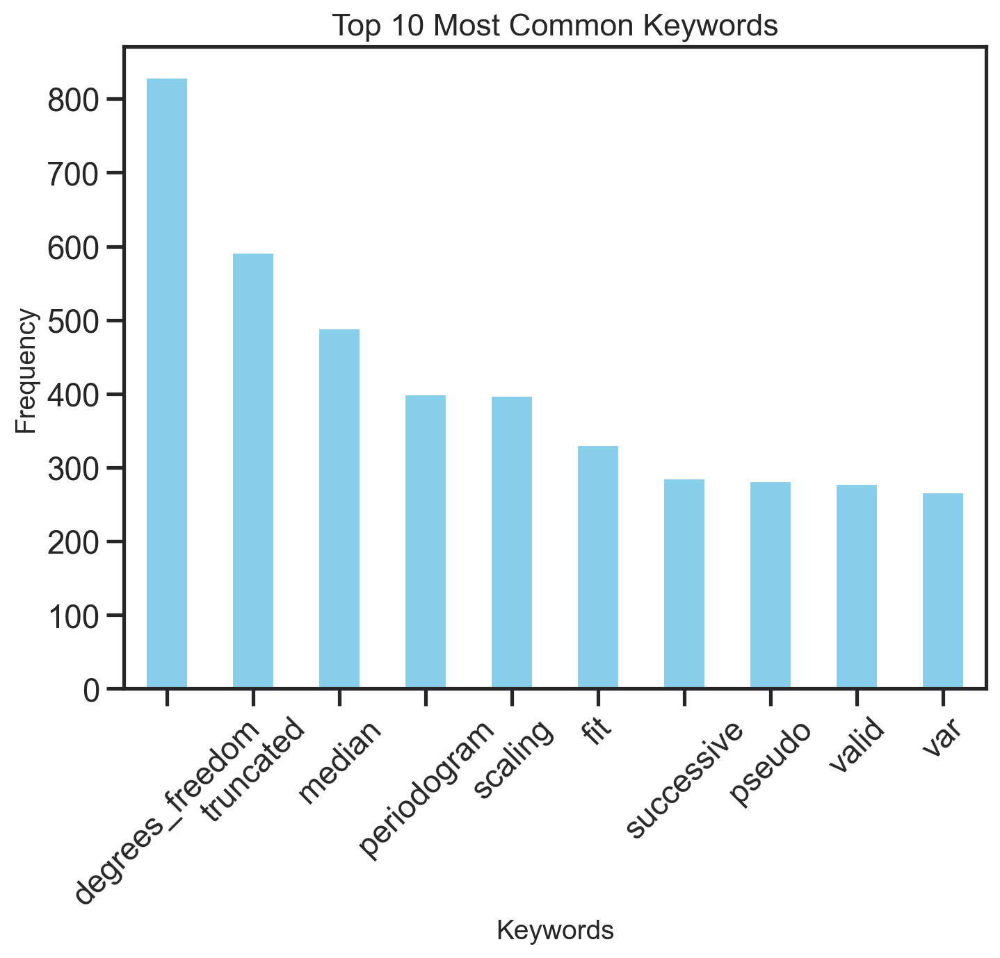

In [19]:
# Visualization
# Create a Bar Chart for the Top Keywords
plt.figure(figsize=(8, 6))
keyword_frequency.head(10).plot(kind='bar', color='skyblue')
plt.title('Top 10 Most Common Keywords', fontsize=16)
plt.xlabel('Keywords', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.xticks(rotation=45)
plt.show()

c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\wordcloud\wordcloud.py:522: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\wordcloud\wordcloud.py:499: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = Image.ROTATE_90
c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\wordcloud\wordcloud.py:499: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = Image.ROTATE_90
c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\wordcloud\wordcloud.py:523: DeprecationWarning: ROTATE_90 is deprecated and will be rem

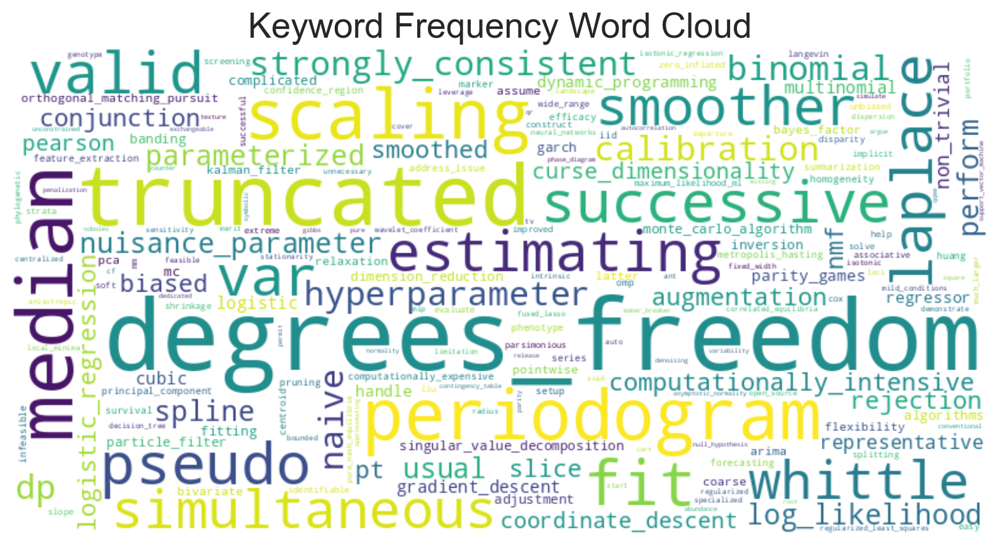

In [20]:
# Create a Word Cloud
plt.figure(figsize=(10, 6))
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(keyword_frequency)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  # Turn off axis
plt.title('Keyword Frequency Word Cloud', fontsize=20)
plt.show()

Clustering with K-Means

In [21]:
# First, we need to calculate the average vectors for each abstract
average_vectors = []

for abstract in dataset.documents:
    avg_vector = find_keywords_by_similarity(abstract, dataset)
    if avg_vector is not None:
        average_vectors.append(avg_vector)

# Convert to a NumPy array for K-Means
average_vectors = np.array(average_vectors)

# Perform K-Means clustering
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(average_vectors)

# Add cluster labels to the DataFrame
keywords_df['Cluster'] = kmeans.labels_

keywords_df

,Abstract #,Keywords,Cluster
0,1,"[screening, flexibility, marker, alternate, post]",1
1,2,"[cosmological, circular, outlying, variability...",1
2,3,"[degrees_freedom, median, curse_dimensionality...",3
3,4,"[child, sea, fall, suitability, seal]",2
4,5,"[latter, explicit_expression, ordinary, weakly...",3
...,...,...,...
9995,9996,"[soft, solve, handle, mqc, nmf]",1
9996,9997,"[release, amazon, audit, bangla_character, kdd]",2
9997,9998,"[departure, spread, accounting, genotype, rain...",2
9998,9999,"[run, candidate, sized, proportional, bin]",4


Topic Modeling with LDA

Create TopicModel class

In [22]:
class TopicModel:

    """The topic model class."""

    def __init__(self, model_path, dataset_path):
        self.model = LdaModel.load(model_path)
        self.dataset = ArXivDataset.load(dataset_path)
        self.num_topics = self.model.num_topics
        self.topic_names = list(range(self.num_topics))
        self.topics = self.model.show_topics(num_topics=self.num_topics)

    def set_topic_names(self, names):
        # Ensure topic_names is truncated or padded to match num_topics
        names = names[:self.num_topics] # Truncate if longer
        # or pad if shorter: names += [f"Topic {i}" for i in range(len(names), self.num_topics)]

        self.topic_names = names
        topic_terms = self.model.show_topics(num_topics=self.num_topics)
        self.topics = []
        for i, name in enumerate(names):
            self.topics.append((name, topic_terms[i][1]))

    def predict(self, text):
        tokens = simple_preprocess(text)  # Using simple_preprocess for tokenization
        bow_transformed = self.dataset.to_bow([tokens])[0]  # Passing the list of tokens
        topic_predictions = self.model.get_document_topics(bow_transformed)
        sorted_predictions = sorted(topic_predictions, key=lambda x: x[1], reverse=True)
        sorted_predictions = [(self.topic_names[topic_idx], prob) for (topic_idx, prob) in sorted_predictions]
        return sorted_predictions

Evaluating LDA models using coherence scores

In [23]:
# Set hyperparameters
num_topics_list = [10, 11, 12, 13, 14, 15, 16]
num_passes = 5
random_state = 929

In [24]:
# Run grid search for LDA models
model_list = []
score_list = []

for num_topics in num_topics_list:
    model = LdaModel(corpus=dataset.corpus, id2word=dataset.idx2word,
                     num_topics=num_topics, passes=num_passes,
                     random_state=random_state, per_word_topics=True)
    model_list.append(model)
    coherence_model = CoherenceModel(model=model, texts=dataset.documents,
                                     dictionary=dataset.idx2word, coherence="c_v")
    score = coherence_model.get_coherence()
    score_list.append(score)

    print(" * num_topics: {n:02d}\tscore: {s:.3f}".format(n=num_topics, s=score))

c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\sparse\_sputils.py:44: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  upcast = np.find_common_type(args, [])
c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\sparse\_sputils.py:44: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  upcast = np.find_common_type(args, [])
c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\sparse\_sputils.py:44: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs

 * num_topics: 10	score: 0.463
 * num_topics: 11	score: 0.457
 * num_topics: 12	score: 0.452
 * num_topics: 13	score: 0.461
 * num_topics: 14	score: 0.449
 * num_topics: 15	score: 0.457
 * num_topics: 16	score: 0.459


c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\ROG Zephyrus PC\AppData\Local\Programs\Python\Python311\Lib\site-packages\sea

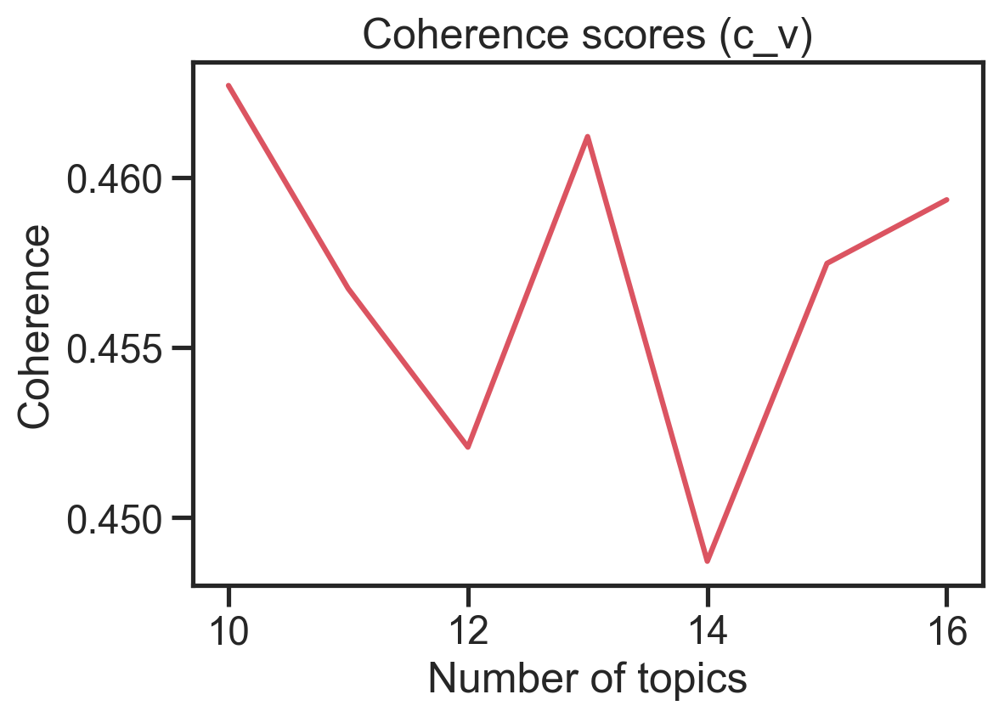

In [25]:
# Plot coherence scores
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.set_title("Coherence scores (c_v)")
sns.lineplot(x=num_topics_list, y=score_list, color="#DB5461", ax=ax, legend=False)
ax.set_xlabel("Number of topics")
ax.set_ylabel("Coherence")
plt.show()

In [26]:
# Export best model
os.makedirs("./models", exist_ok=True)

best_idx = np.argmax(score_list)
best_model = model_list[best_idx]
best_score = score_list[best_idx]
num_topics = num_topics_list[best_idx]
best_model_path = f"./models/lda_n{num_topics}_p{num_passes}_r{random_state}_c{round(best_score * 100, 1)}"
best_model.save(best_model_path)
print("Model saved to {path}".format(path=best_model_path))

Model saved to ./models/lda_n10_p5_r929_c46.3


In [27]:
# Apply best model path with TopicModel class
model_path = best_model_path
dataset_path = "dataset.obj"
model = TopicModel(model_path, dataset_path)

In [28]:
# Print topics
pprint(model.topics)

[(0,
  '0.015*"theory" + 0.012*"logic" + 0.010*"probability" + 0.009*"proof" + '
  '0.008*"property" + 0.007*"formula" + 0.007*"notion" + 0.007*"complexity" + '
  '0.007*"representation" + 0.007*"set"'),
 (1,
  '0.024*"problem" + 0.024*"network" + 0.016*"algorithm" + 0.015*"model" + '
  '0.014*"paper" + 0.013*"approach" + 0.013*"search" + 0.011*"system" + '
  '0.010*"constraint" + 0.009*"domain"'),
 (2,
  '0.054*"process" + 0.027*"time" + 0.013*"model" + 0.012*"system" + '
  '0.009*"population" + 0.009*"stochastic" + 0.009*"dynamic" + 0.009*"change" '
  '+ 0.009*"point" + 0.008*"state"'),
 (3,
  '0.027*"estimator" + 0.021*"function" + 0.017*"distribution" + '
  '0.012*"result" + 0.011*"rate" + 0.011*"random" + 0.011*"matrix" + '
  '0.011*"density" + 0.010*"estimation" + 0.009*"asymptotic"'),
 (4,
  '0.035*"method" + 0.031*"image" + 0.027*"datum" + 0.018*"algorithm" + '
  '0.015*"feature" + 0.012*"classification" + 0.011*"technique" + '
  '0.010*"paper" + 0.009*"approach" + 0.009*"detec

In [29]:
# Visualization the topics
pyLDAvis.enable_notebook()

vis = pyLDAvis.gensim_models.prepare(model.model, model.dataset.corpus, model.dataset.idx2word)

pyLDAvis.display(vis)

### Using Transformers to generate the Topic Name

#### Not Neccessary Right Now

In [ ]:
!pip install transformers


In [ ]:
from transformers import pipeline

# Load summarization pipeline
summarizer = pipeline("summarization", model="facebook/bart-large-cnn")

def generate_topic_name(keywords):
    """Generate a topic name by summarizing the keywords."""
    text = " ".join(keywords)
    summary = summarizer(text, max_length=10, min_length=5, do_sample=False)
    return summary[0]['summary_text']

# Generate topic names for each topic
topic_names = []
for topic in model.topics:
    topic_keywords = topic[1].split(" + ")
    keywords = [kw.split("*")[1].replace('"', '').strip() for kw in topic_keywords]
    topic_name = generate_topic_name(keywords)
    topic_names.append(topic_name)

# Set the generated topic names
model.set_topic_names(topic_names)
pprint(model.topics)

### Using Pre-trained word embeddinng Google News Vectors to generate Topic_name

In [ ]:
import gensim.downloader as api

# Load pre-trained word embeddings (e.g., Google News vectors) from gensim API
word_vectors = api.load('word2vec-google-news-300')


# from gensim.models import KeyedVectors

# # Load pre-trained word embeddings (e.g., Google News vectors)
# word_vectors = KeyedVectors.load_word2vec_format('GoogleNews-vectors-negative300.bin', binary=True)

def get_top_terms_per_topic(model, num_terms=10):
    """Extract the top terms from each topic."""
    top_terms = {}
    for topic_id in range(model.num_topics):
        terms = model.show_topic(topic_id, num_terms)
        top_terms[topic_id] = [term for term, _ in terms]
    return top_terms

def compute_average_embedding(terms, word_vectors):
    """Compute the average embedding for a list of terms."""
    valid_embeddings = [word_vectors[term] for term in terms if term in word_vectors]
    if valid_embeddings:
        return np.mean(valid_embeddings, axis=0)
    return None

def get_closest_words(embedding, word_vectors, top_n=3):
    """Find the closest words in the embedding space to the given embedding."""
    if embedding is not None:
        return word_vectors.similar_by_vector(embedding, topn=top_n)
    return []

# Extract top terms from each topic
top_terms_per_topic = get_top_terms_per_topic(model.model)

# Compute average embeddings for each topic
average_embeddings = {}
for topic_id, terms in top_terms_per_topic.items():
    average_embeddings[topic_id] = compute_average_embedding(terms, word_vectors)

# Find the closest words to the average embeddings
topic_names = []
for topic_id, embedding in average_embeddings.items():
    closest_words = get_closest_words(embedding, word_vectors, top_n=3)
    if closest_words:
        topic_name = " ".join([word for word, _ in closest_words])
        topic_names.append(topic_name)
    else:
        topic_names.append(f"Topic {topic_id}")

# Set the generated topic names
model.set_topic_names(topic_names)
pprint(model.topics)


[('theory logic notion',
  '0.015*"theory" + 0.012*"logic" + 0.010*"probability" + 0.009*"proof" + '
  '0.008*"property" + 0.007*"formula" + 0.007*"notion" + 0.007*"complexity" + '
  '0.007*"representation" + 0.007*"set"'),
 ('algorithm system simulated_annealing',
  '0.024*"problem" + 0.024*"network" + 0.016*"algorithm" + 0.015*"model" + '
  '0.014*"paper" + 0.013*"approach" + 0.013*"search" + 0.011*"system" + '
  '0.010*"constraint" + 0.009*"domain"'),
 ('stochastic system process',
  '0.054*"process" + 0.027*"time" + 0.013*"model" + 0.012*"system" + '
  '0.009*"population" + 0.009*"stochastic" + 0.009*"dynamic" + 0.009*"change" '
  '+ 0.009*"point" + 0.008*"state"'),
 ('matrix impedance_measurements stochasticity',
  '0.027*"estimator" + 0.021*"function" + 0.017*"distribution" + '
  '0.012*"result" + 0.011*"rate" + 0.011*"random" + 0.011*"matrix" + '
  '0.011*"density" + 0.010*"estimation" + 0.009*"asymptotic"'),
 ('method technique algorithm',
  '0.035*"method" + 0.031*"image" + 0.

Create a scrape function for scraping arxiv abstract

In [46]:
def scrape_arxiv_abstract(paper_url):

    """Scrape arXiv abstract from url."""

    try:
        page = requests.get(paper_url)
        soup = BeautifulSoup(page.content, "html.parser")
        abstract = soup.find("blockquote", {"class": "abstract mathjax"})
        title = soup.find("h1", {"class": "title mathjax"})
        abstract.span.decompose()
        title.span.decompose()
        return title.text + "\n" + abstract.text
    except Exception as e:
        print(e)
        raise

Get predicting the topics

In [47]:
def get_predictions(paper_url):
    try:
        text = scrape_arxiv_abstract(paper_url)
        predictions = model.predict(text)
        return predictions
    except Exception as e:
        return str(e)

url_input = widgets.Text(
    description='Paper URL:',
    placeholder='Enter arXiv paper URL'
)

output = widgets.Output()

def on_button_click(b):
    with output:
        clear_output()
        paper_url = url_input.value.strip()
        if paper_url:
            predictions = get_predictions(paper_url)
            print(f"Predictions for {paper_url}:")
            for topic, score in predictions:
                print(f"  - {topic}: {score: .4f}")
        else:
            print("Please enter a valid URL.")

button = widgets.Button(description="Get Predictions")
button.on_click(on_button_click)

display(url_input, button, output)

Text(value='', description='Paper URL:', placeholder='Enter arXiv paper URL')

Button(description='Get Predictions', style=ButtonStyle())

Output()